Restarted Python 3.9.13

In [1]:
## Load lib
import numpy as np
import os
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.colors import ListedColormap

import torch
import albumentations as A
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
from torch.optim import RMSprop

from tqdm.notebook import tqdm

import time

from sklearn.model_selection import train_test_split

# from google.colab import drive
# drive.mount('/content/drive')
# Load the TensorBoard notebook extension

torch.cuda.is_available()

True

In [2]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 512
INPUT_IMAGE_HEIGHT = 512

# define threshold to filter weak predictions
THRESHOLD = 0.5

cuda


In [3]:
## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

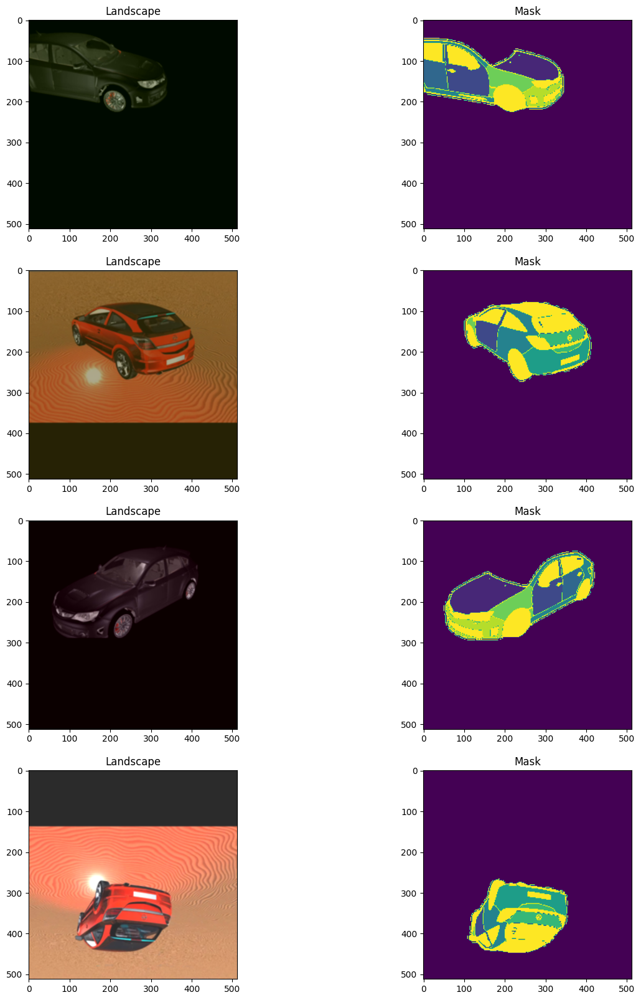

In [4]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [5]:
## unet
# https://medium.com/analytics-vidhya/unet-implementation-in-pytorch-idiot-developer-da40d955f201

class conv_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_c)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_c)
        self.relu = nn.ReLU()
    def forward(self, inputs):
        x = self.conv1(inputs)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x

class encoder_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.conv = conv_block(in_c, out_c)
        self.pool = nn.MaxPool2d((2, 2))
    def forward(self, inputs):
        x = self.conv(inputs)
        p = self.pool(x)
        return x, p

class decoder_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_c, out_c, kernel_size=2, stride=2, padding=0)
        self.conv = conv_block(out_c+out_c, out_c)
    def forward(self, inputs, skip):
        x = self.up(inputs)
        x = torch.cat([x, skip], axis=1)
        x = self.conv(x)
        return x

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        #""" Encoder """
        self.e1 = encoder_block(3, 64)
        self.e2 = encoder_block(64, 128)
        self.e3 = encoder_block(128, 256)
        self.e4 = encoder_block(256, 512)
        #""" Bottleneck """
        self.b = conv_block(512, 1024)
        #""" Decoder """
        self.d1 = decoder_block(1024, 512)
        self.d2 = decoder_block(512, 256)
        self.d3 = decoder_block(256, 128)
        self.d4 = decoder_block(128, 64)
        #""" Classifier """
        self.outputs = nn.Conv2d(64, NUM_CLASSES, kernel_size=1, padding=0)
    def forward(self, inputs):
        #""" Encoder """
        s1, p1 = self.e1(inputs)
        s2, p2 = self.e2(p1)
        s3, p3 = self.e3(p2)
        s4, p4 = self.e4(p3)
        #""" Bottleneck """
        b = self.b(p4)
        #""" Decoder """
        d1 = self.d1(b, s4)
        d2 = self.d2(d1, s3)
        d3 = self.d3(d2, s2)
        d4 = self.d4(d3, s1)
        #""" Classifier """
        outputs = self.outputs(d4)
        return outputs

In [6]:
## Train

# initialize our UNet model
unet = UNet().to(DEVICE)

# initialize loss function and optimizer
criterion = nn.CrossEntropyLoss()
opt = RMSprop(unet.parameters(), lr=INIT_LR,
            weight_decay=INIT_WEIGHT_DECAY, momentum=MOMENTUM, foreach=True)

# calculate steps per epoch for training and test set
trainSteps = len(trainDS) // BATCH_SIZE
testSteps = len(testDS) // BATCH_SIZE

# Check tensor shapes
batch = next(iter(trainLoader))
images, mask = batch
print(images.shape, mask.shape, type(images), type(mask), images.dtype, mask.dtype)

#Training LOOP
#torch.cuda.empty_cache()

# initialize a dictionary to store training history
H = {"train_loss": [], "test_loss": [], "train_step": [], "test_step": []}
train_step_loss  = []
test_step_loss  = []

for epoch in range(NUM_EPOCHS):
    # initialize the total training and validation loss
    totalTrainLoss = 0
    totalTestLoss = 0
    # 1) Train model
    unet.train()
    for X, Y in tqdm(trainLoader, total=len(trainLoader), leave=False):
        X, Y = X.to(DEVICE), Y.to(DEVICE)
        Y_pred = unet(X)
        trainLoss = criterion(Y_pred, Y)

        opt.zero_grad()
        trainLoss.backward()
        opt.step()

        totalTrainLoss += trainLoss
        train_step_loss.append(trainLoss.cpu().detach().numpy())

    

    # 2) Val model
    with torch.no_grad():
        # set the model in evaluation mode
        unet.eval()
		# loop over the validation set
        for (x, y) in tqdm(testLoader, total=len(testLoader), leave=False):
			# send the input to the device
            (x, y) = (x.to(DEVICE), y.to(DEVICE))
			# make the predictions and calculate the validation loss
            pred = unet(x)
            testLoss = criterion(pred, y)
            totalTestLoss += testLoss
            
            test_step_loss.append(testLoss.cpu().detach().numpy())


    # calculate the average training and validation loss
    avgTrainLoss = totalTrainLoss / trainSteps
    avgTestLoss = totalTestLoss / testSteps

    # update our training history
    H["train_loss"].append(avgTrainLoss.cpu().detach().numpy())
    H["test_loss"].append(avgTestLoss.cpu().detach().numpy())

	# print the model training and validation information
    print("[INFO] EPOCH: {}/{}".format(epoch + 1, NUM_EPOCHS))
    print("Train loss: {:.6f}, Test loss: {:.4f}".format(
		avgTrainLoss, avgTestLoss))

torch.Size([4, 3, 512, 512]) torch.Size([4, 512, 512]) <class 'torch.Tensor'> <class 'torch.Tensor'> torch.float32 torch.int64


  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

[INFO] EPOCH: 1/1
Train loss: 0.848224, Test loss: 3.4361


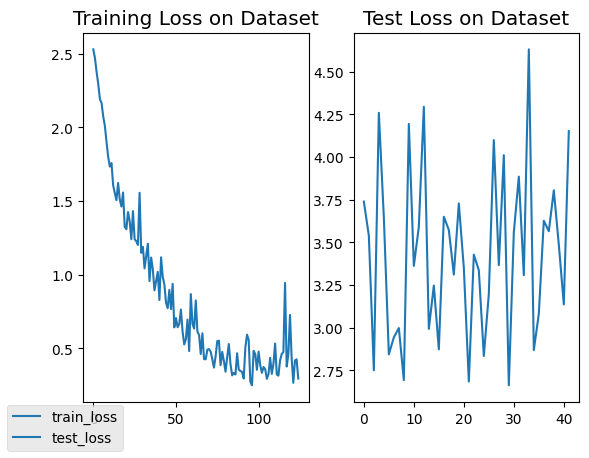

In [7]:
# plot the training loss
fig, axes = plt.subplots(1, 2)
plt.style.use("ggplot")
axes[0].plot(train_step_loss, label="train_loss")
axes[1].plot(test_step_loss, label="test_loss")
axes[0].set_title("Training Loss on Dataset")
axes[1].set_title("Test Loss on Dataset")
fig.legend(loc="lower left")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


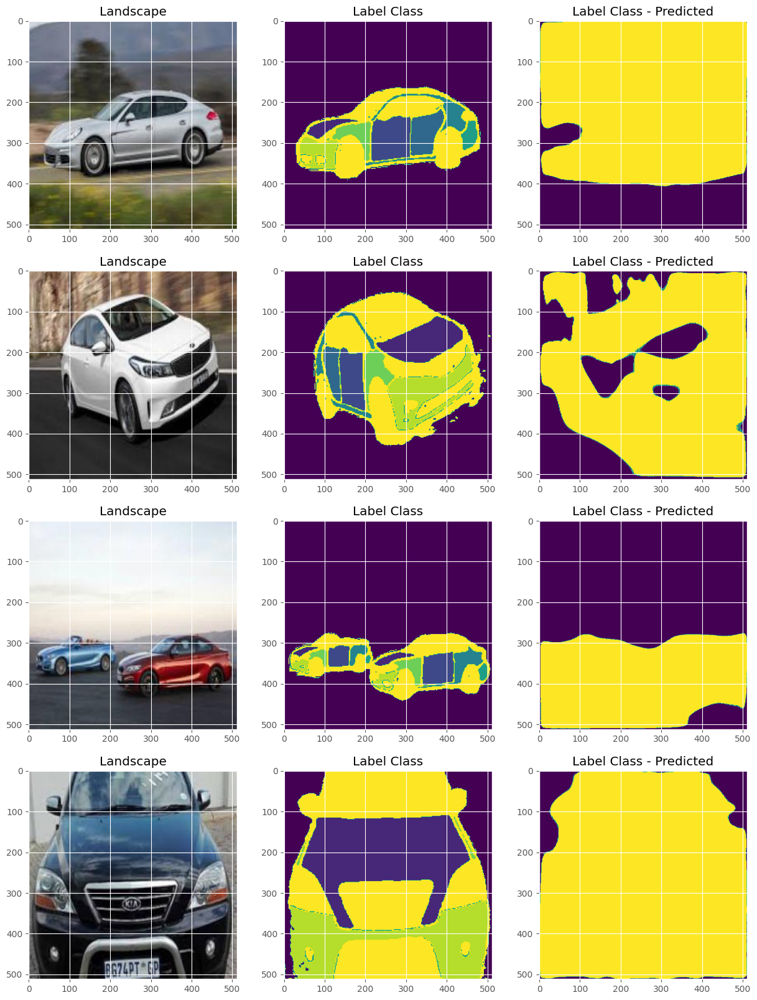

In [8]:
##Aftermath
X, Y = next(iter(testLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


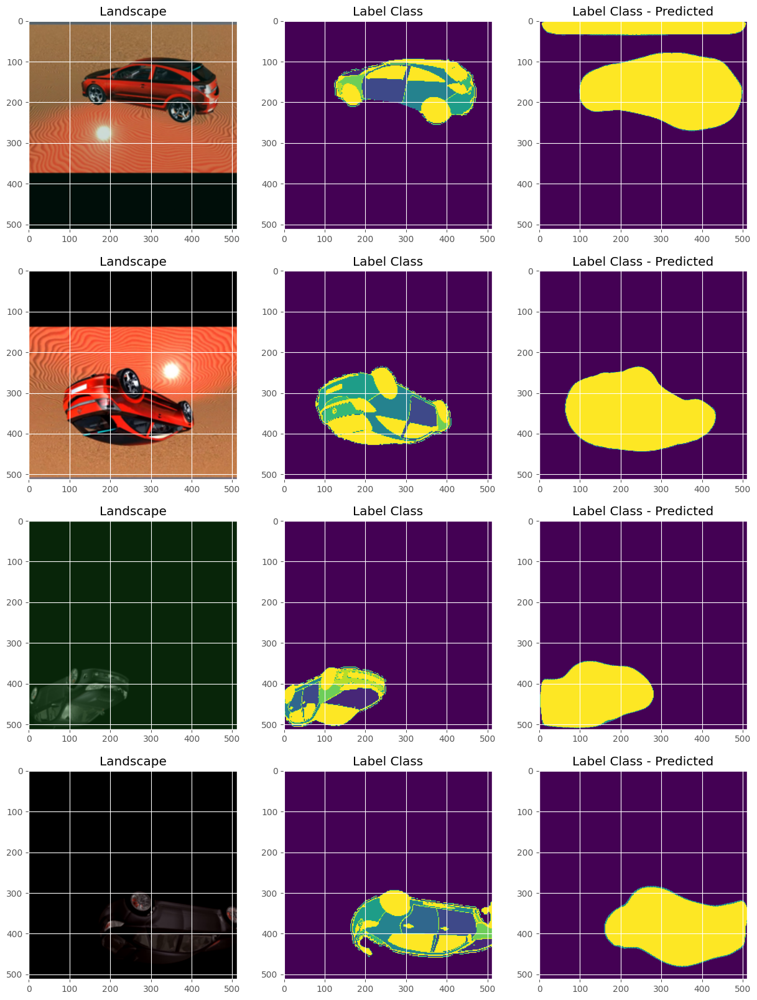

In [9]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


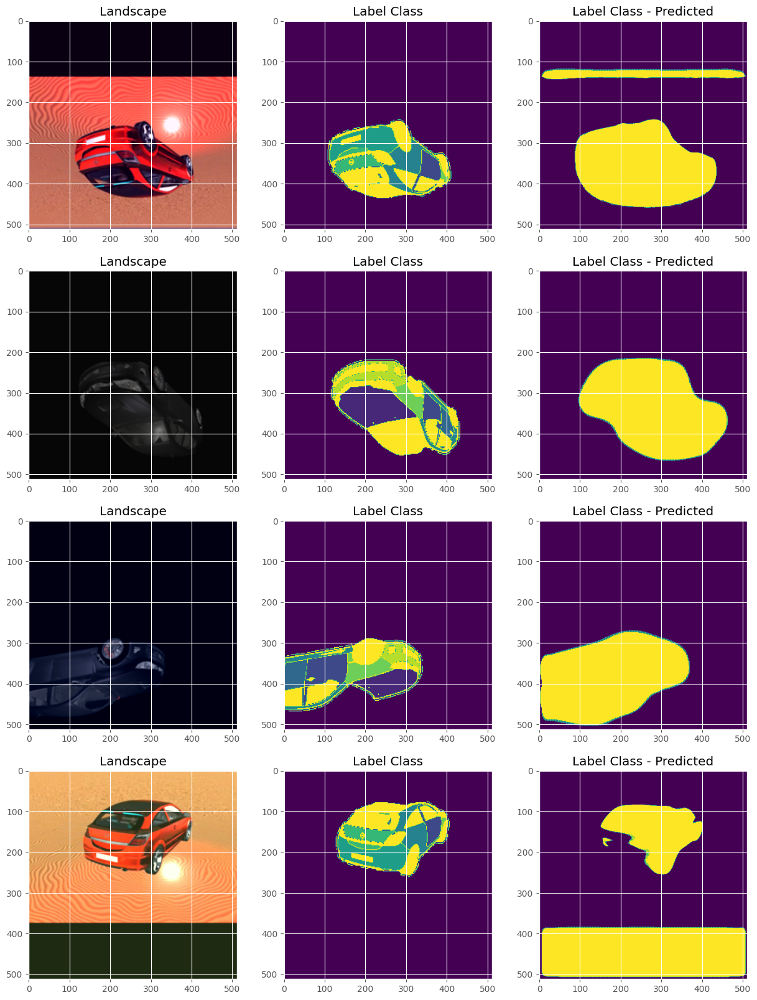

In [10]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


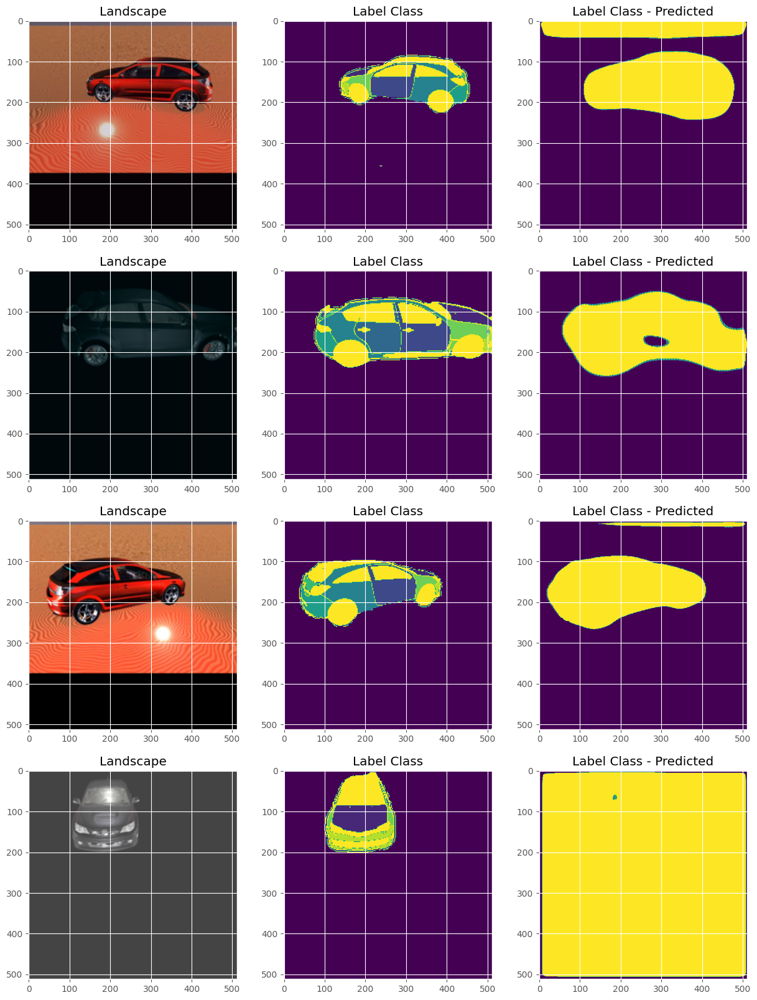

In [11]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


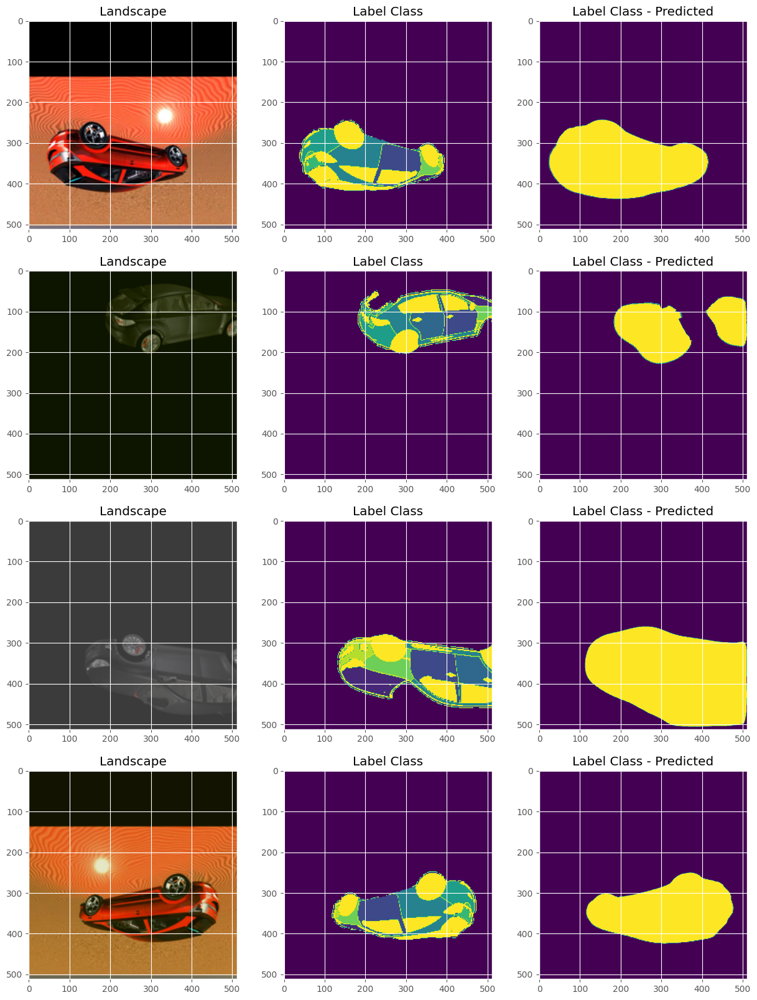

In [12]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


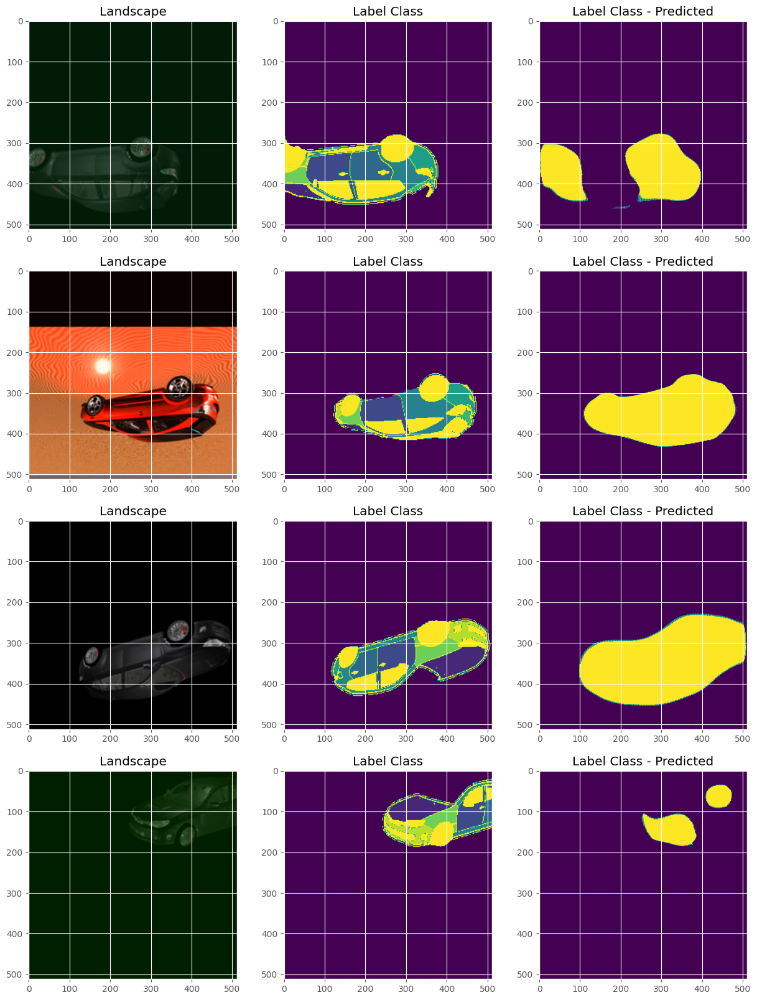

In [13]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([4, 10, 512, 512])
torch.Size([4, 512, 512])


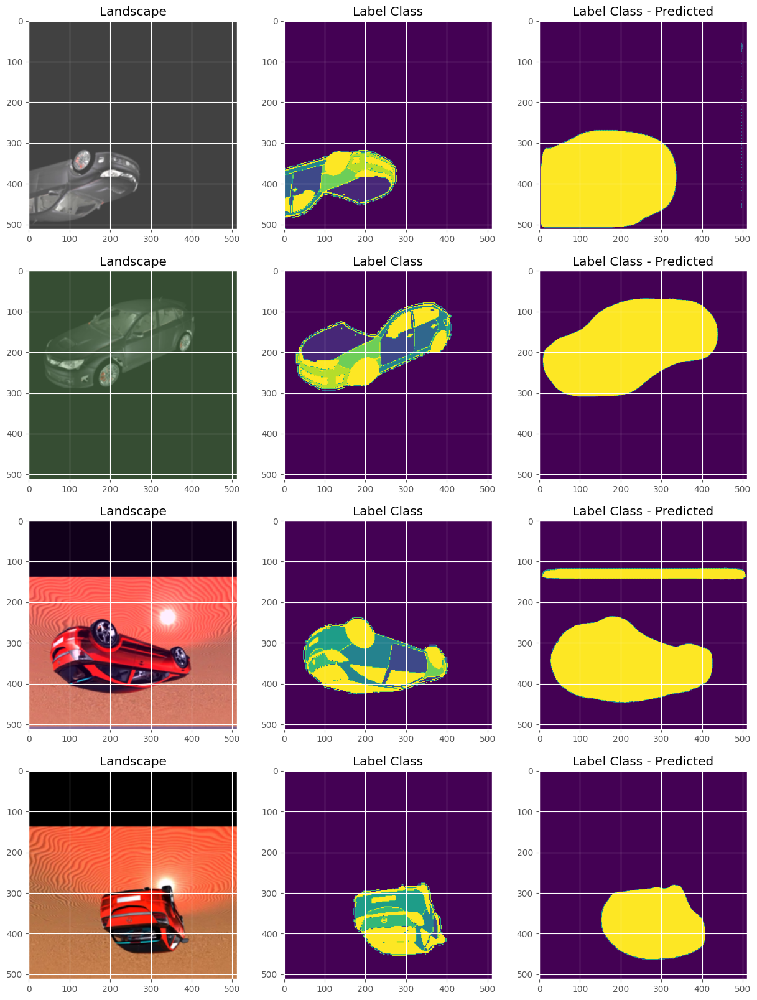

In [14]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

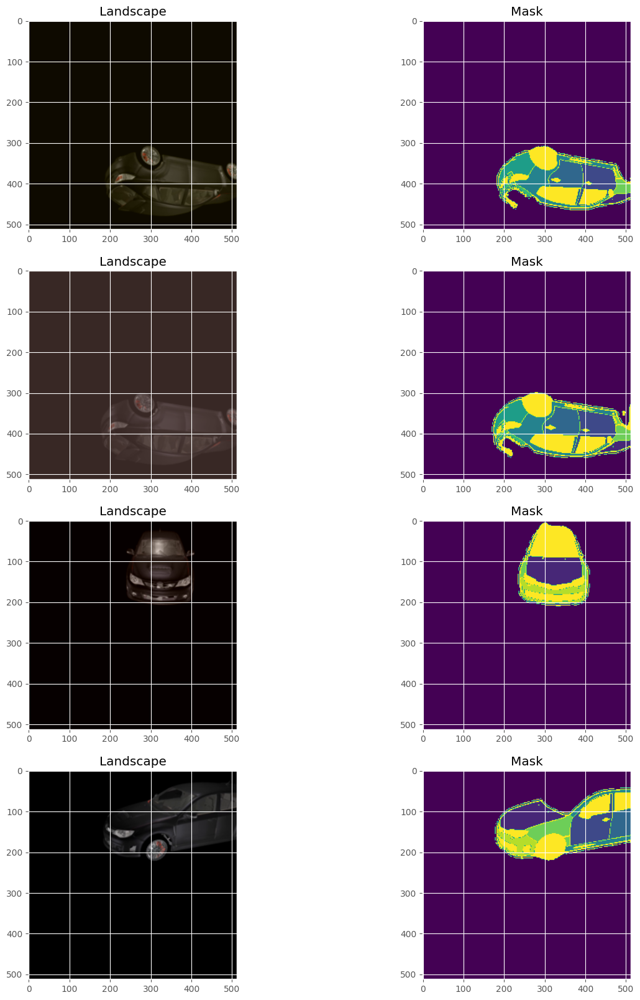

In [15]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

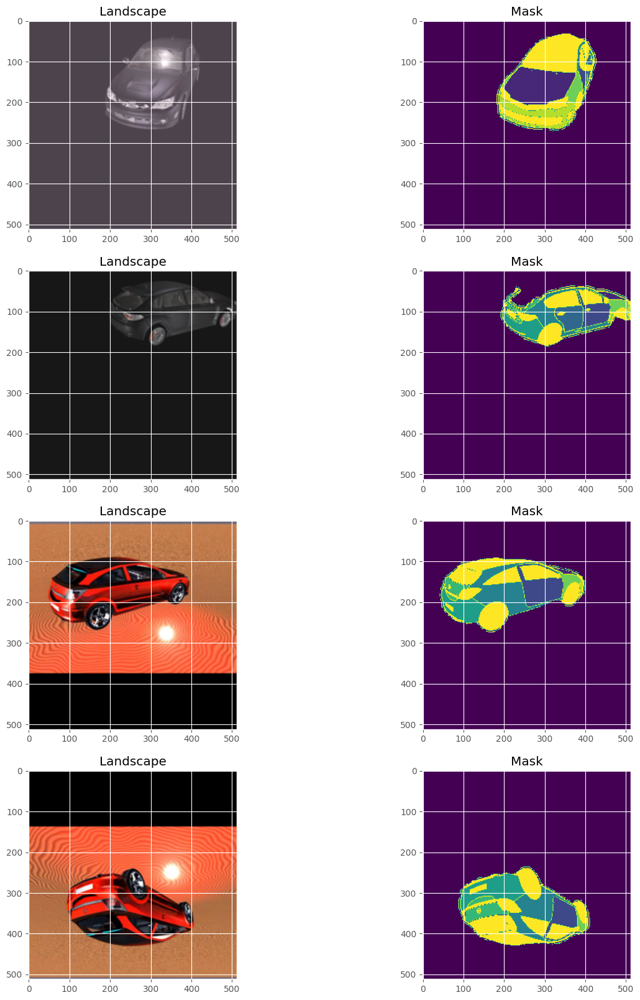

In [16]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [17]:
## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

test = np.load(test_images[0])
test = test[:,:,:3]

print(test.shape)

(256, 256, 3)


In [18]:
## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

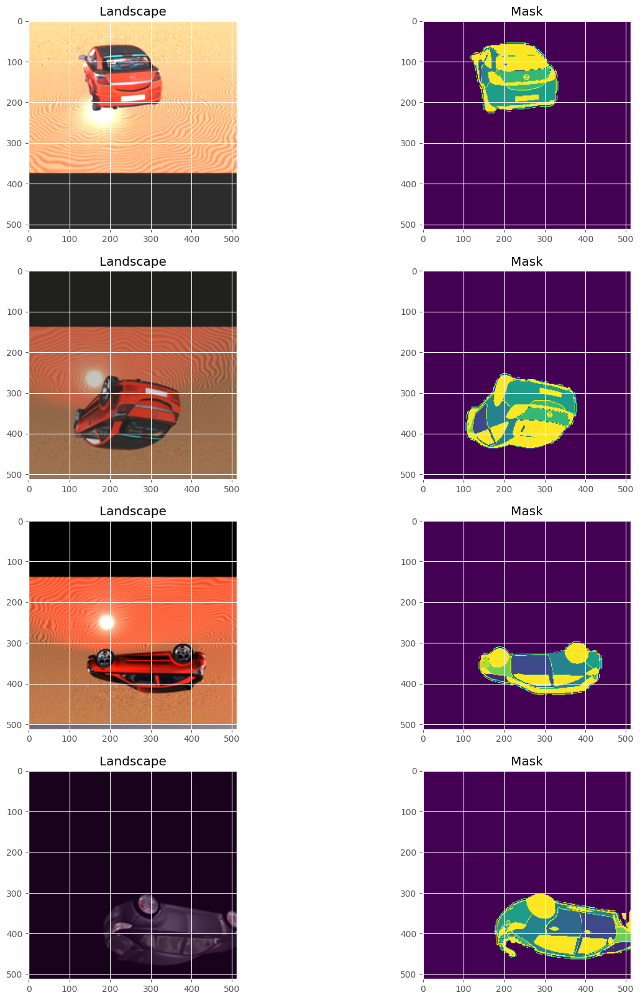

In [19]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [20]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 256
INPUT_IMAGE_HEIGHT = 256

# define threshold to filter weak predictions
THRESHOLD = 0.5

cuda


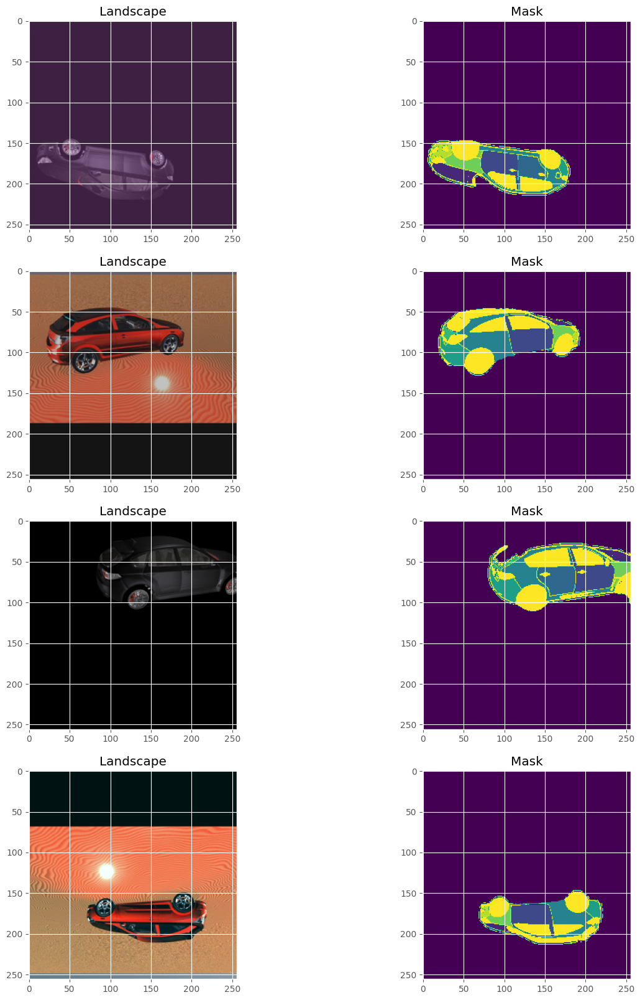

In [21]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [22]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 200
INPUT_IMAGE_HEIGHT = 256

# define threshold to filter weak predictions
THRESHOLD = 0.5

cuda


In [23]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 200
INPUT_IMAGE_HEIGHT = 256

# define threshold to filter weak predictions
THRESHOLD = 0.5

## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

cuda


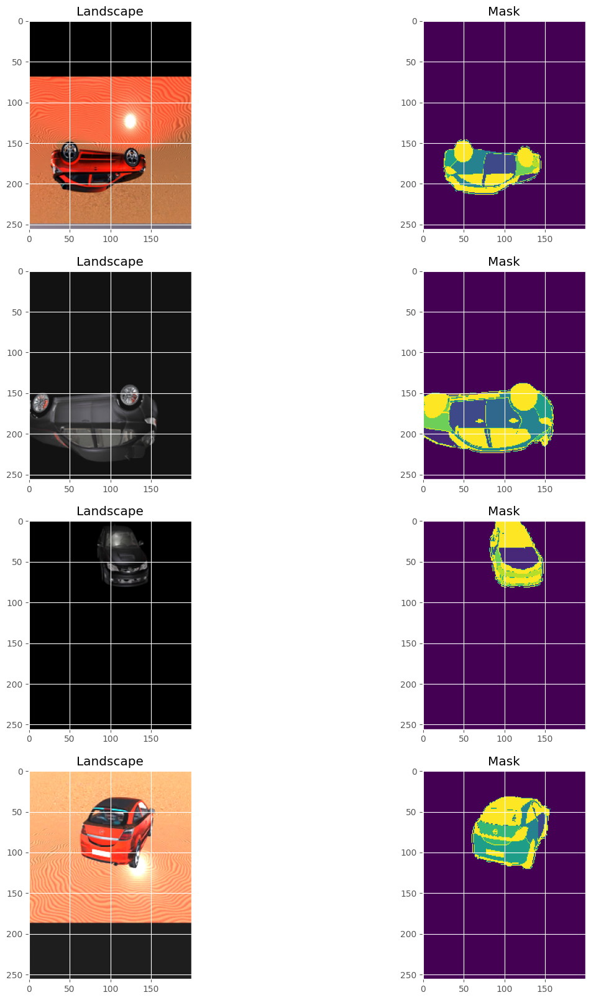

In [24]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths
    
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [25]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 256
INPUT_IMAGE_HEIGHT = 200

# define threshold to filter weak predictions
THRESHOLD = 0.5

## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

cuda


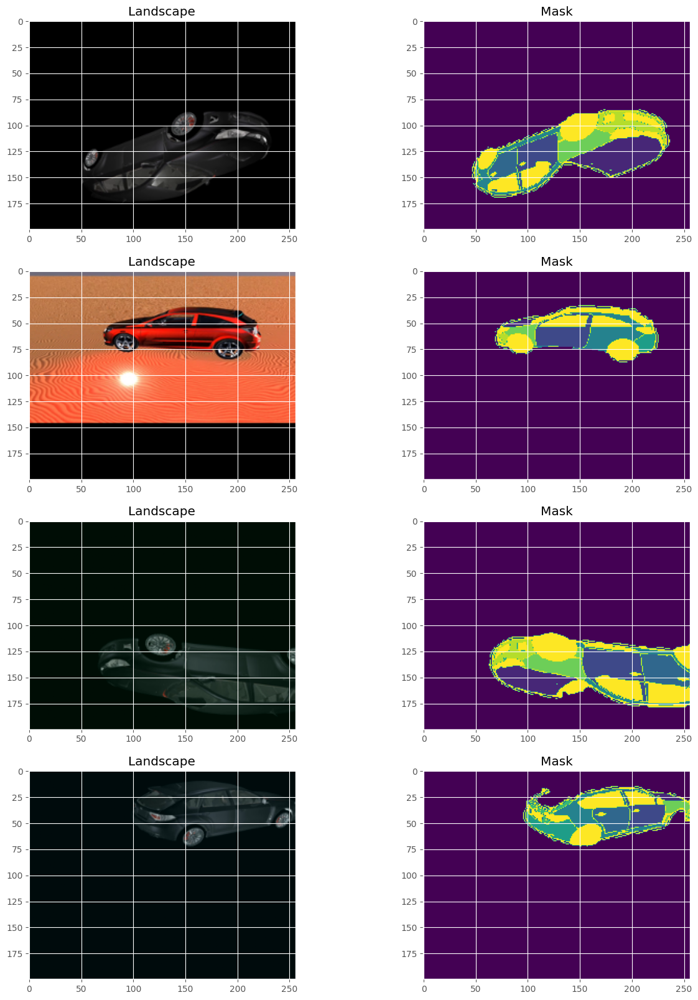

In [26]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [27]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 1
BATCH_SIZE = 4

# define the input image dimensions
INPUT_IMAGE_WIDTH = 256
INPUT_IMAGE_HEIGHT = 256

# define threshold to filter weak predictions
THRESHOLD = 0.5

## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

cuda


In [28]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:200,:3]
    mask = arrayz[:,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

ValueError: Height and Width of image, mask or masks should be equal. You can disable shapes check by setting a parameter is_check_shapes=False of Compose class (do it only if you are sure about your data consistency).

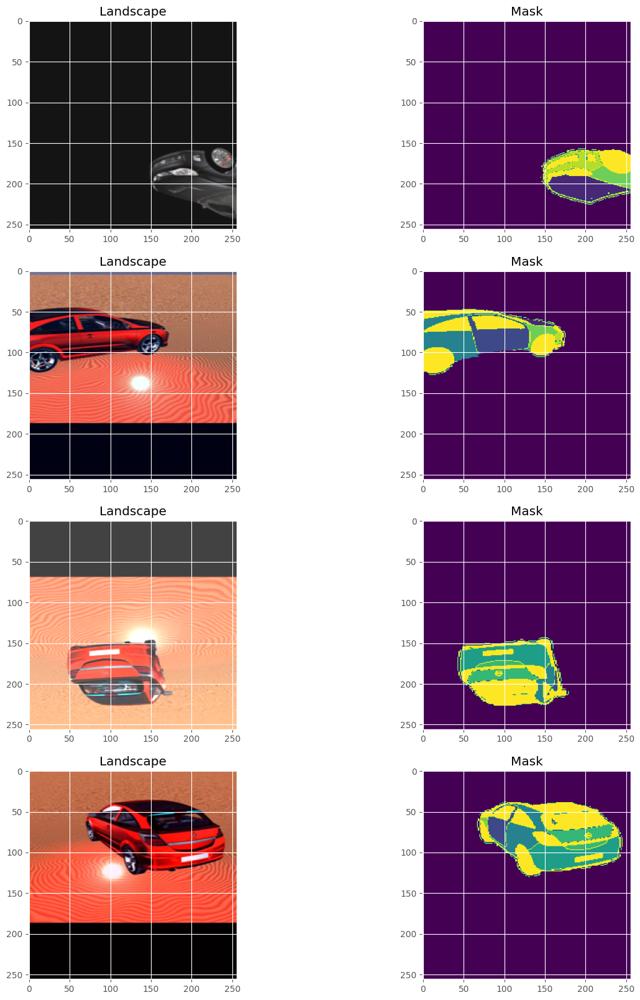

In [29]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:,:200,:3]
    mask = arrayz[:,:200,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

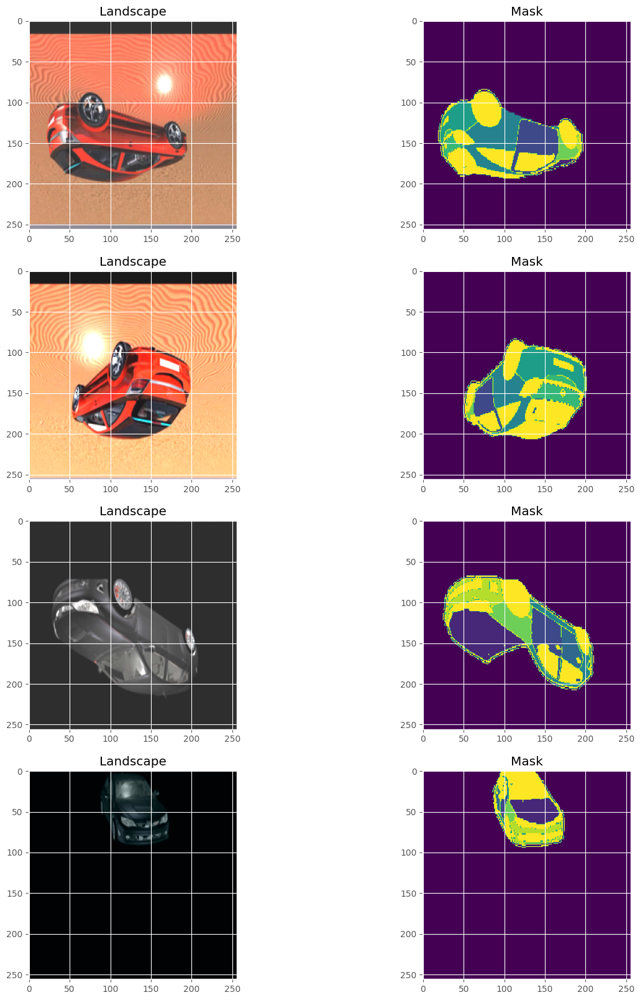

In [30]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:200,:,:3]
    mask = arrayz[:200,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [31]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:290,:,:3]
    mask = arrayz[:190,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

ValueError: Height and Width of image, mask or masks should be equal. You can disable shapes check by setting a parameter is_check_shapes=False of Compose class (do it only if you are sure about your data consistency).

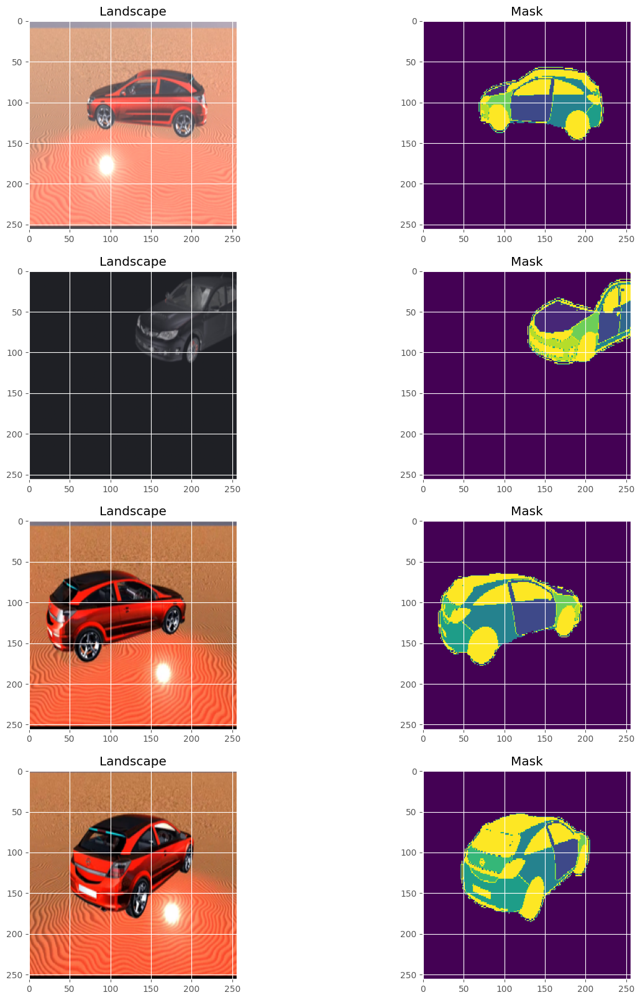

In [32]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:190,:,:3]
    mask = arrayz[:190,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

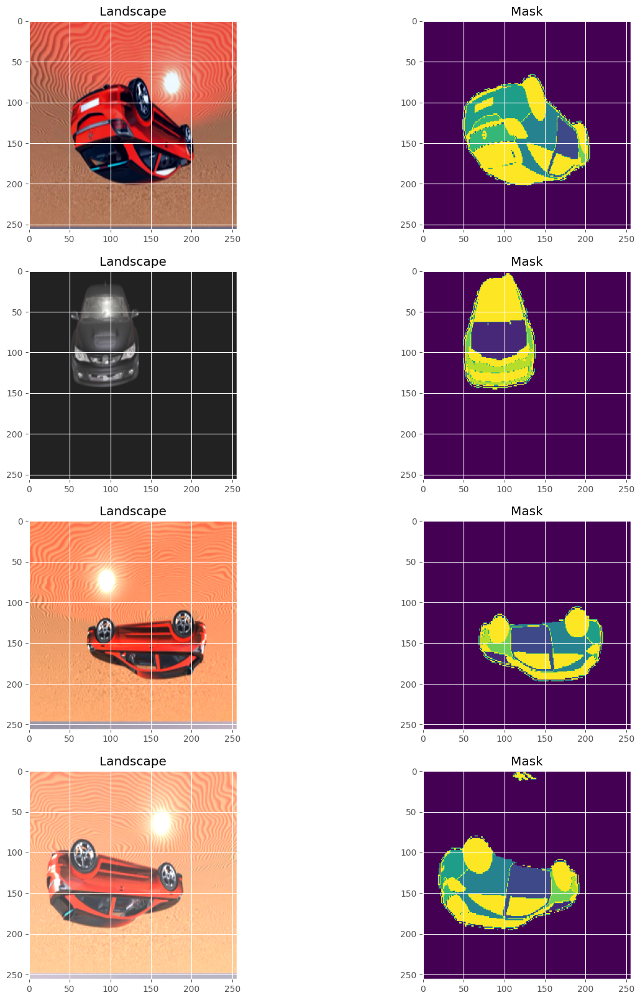

In [33]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:185,:,:3]
    mask = arrayz[:185,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

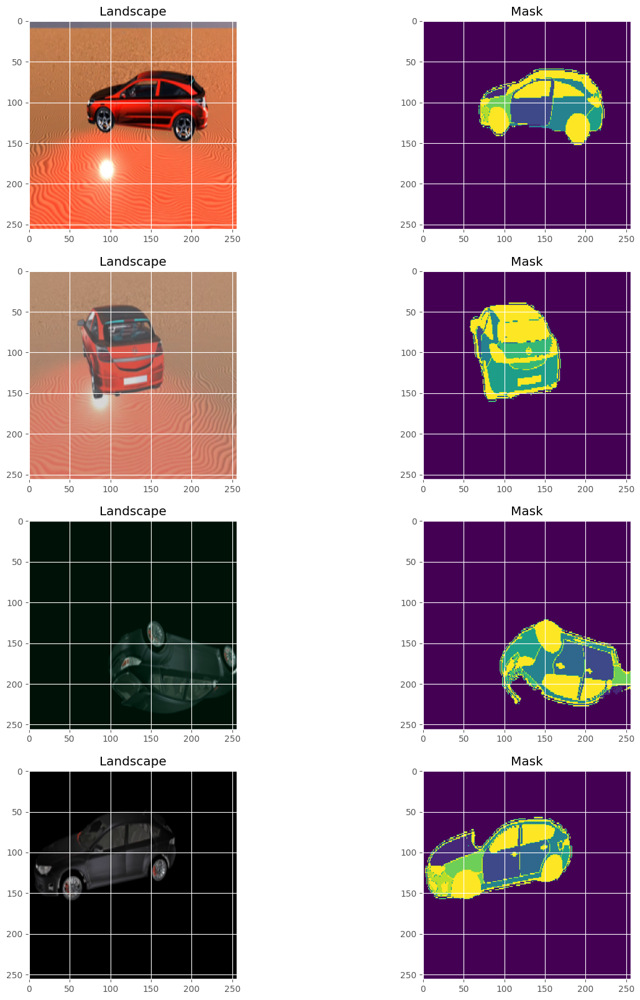

In [34]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:185,:,:3]
    mask = arrayz[:185,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

Restarted Python 3.9.13

In [1]:
## Load lib
import numpy as np
import os
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib.colors import ListedColormap

import torch
import albumentations as A
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
from torch.optim import RMSprop

from tqdm.notebook import tqdm

import time

from sklearn.model_selection import train_test_split

# from google.colab import drive
# drive.mount('/content/drive')
# Load the TensorBoard notebook extension

torch.cuda.is_available()

True

In [2]:
## CONFIG
# define the test split
TEST_SPLIT = 0.15

# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)

# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False
 
# define the number of number of classes
NUM_CLASSES = 10

# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 1e-5
INIT_WEIGHT_DECAY = 1e-8
MOMENTUM = 0.999

NUM_EPOCHS = 5
BATCH_SIZE = 16

# define the input image dimensions
INPUT_IMAGE_WIDTH = 256
INPUT_IMAGE_HEIGHT = 256

# define threshold to filter weak predictions
THRESHOLD = 0.5

## Dataset & Dataloader
#dir = "drive/MyDrive/Colab Notebooks/02456-deep-learning-with-PyTorch-master/SegCarImg/data/"
dir = "C:/Users/uller/OneDrive - Danmarks Tekniske Universitet/Uni/Kandidat/sem3/Deep/projekt/carseg_data/"

photo_count = 169
orange_count = 250 #2001
black_count = 250 #834

test_images = [dir + 'arrays/photo_{:04d}.npy'.format(i) for i in range(1,photo_count)]
train_orange_3_doors_images = [dir + 'arrays/orange_3_doors_{:04d}.npy'.format(i) for i in range(1,orange_count)]
train_black_5_doors_images = [dir + 'arrays/black_5_doors_{:04d}.npy'.format(i) for i in range(1,black_count)]

image_data = []
Image_index = 25

cuda


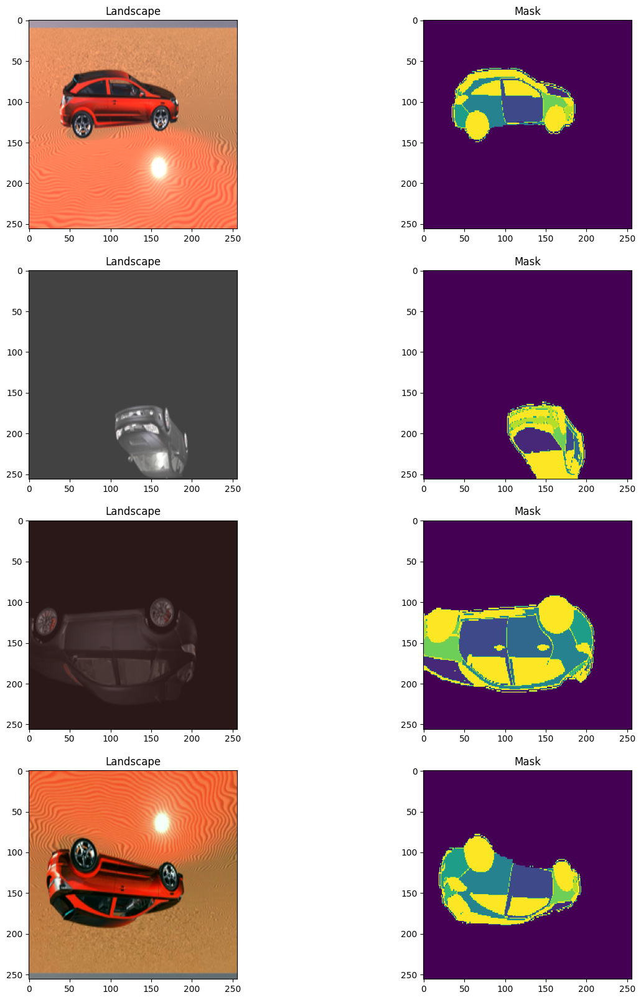

In [3]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms):
    self.arrayPaths = arrayPaths

    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    image = arrayz[:185,:,:3]
    mask = arrayz[:185,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)

# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

In [4]:
## unet
# https://medium.com/analytics-vidhya/unet-implementation-in-pytorch-idiot-developer-da40d955f201

class conv_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_c)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_c)
        self.relu = nn.ReLU()
    def forward(self, inputs):
        x = self.conv1(inputs)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x

class encoder_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.conv = conv_block(in_c, out_c)
        self.pool = nn.MaxPool2d((2, 2))
    def forward(self, inputs):
        x = self.conv(inputs)
        p = self.pool(x)
        return x, p

class decoder_block(nn.Module):
    def __init__(self, in_c, out_c):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_c, out_c, kernel_size=2, stride=2, padding=0)
        self.conv = conv_block(out_c+out_c, out_c)
    def forward(self, inputs, skip):
        x = self.up(inputs)
        x = torch.cat([x, skip], axis=1)
        x = self.conv(x)
        return x

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        #""" Encoder """
        self.e1 = encoder_block(3, 64)
        self.e2 = encoder_block(64, 128)
        self.e3 = encoder_block(128, 256)
        self.e4 = encoder_block(256, 512)
        #""" Bottleneck """
        self.b = conv_block(512, 1024)
        #""" Decoder """
        self.d1 = decoder_block(1024, 512)
        self.d2 = decoder_block(512, 256)
        self.d3 = decoder_block(256, 128)
        self.d4 = decoder_block(128, 64)
        #""" Classifier """
        self.outputs = nn.Conv2d(64, NUM_CLASSES, kernel_size=1, padding=0)
    def forward(self, inputs):
        #""" Encoder """
        s1, p1 = self.e1(inputs)
        s2, p2 = self.e2(p1)
        s3, p3 = self.e3(p2)
        s4, p4 = self.e4(p3)
        #""" Bottleneck """
        b = self.b(p4)
        #""" Decoder """
        d1 = self.d1(b, s4)
        d2 = self.d2(d1, s3)
        d3 = self.d3(d2, s2)
        d4 = self.d4(d3, s1)
        #""" Classifier """
        outputs = self.outputs(d4)
        return outputs

In [5]:
## Train

# initialize our UNet model
unet = UNet().to(DEVICE)

# initialize loss function and optimizer
criterion = nn.CrossEntropyLoss()
opt = RMSprop(unet.parameters(), lr=INIT_LR,
            weight_decay=INIT_WEIGHT_DECAY, momentum=MOMENTUM, foreach=True)

# calculate steps per epoch for training and test set
trainSteps = len(trainDS) // BATCH_SIZE
testSteps = len(testDS) // BATCH_SIZE

# Check tensor shapes
batch = next(iter(trainLoader))
images, mask = batch
print(images.shape, mask.shape, type(images), type(mask), images.dtype, mask.dtype)

#Training LOOP
#torch.cuda.empty_cache()

# initialize a dictionary to store training history
H = {"train_loss": [], "test_loss": [], "train_step": [], "test_step": []}
train_step_loss  = []
test_step_loss  = []

for epoch in range(NUM_EPOCHS):
    # initialize the total training and validation loss
    totalTrainLoss = 0
    totalTestLoss = 0
    # 1) Train model
    unet.train()
    for X, Y in tqdm(trainLoader, total=len(trainLoader), leave=False):
        X, Y = X.to(DEVICE), Y.to(DEVICE)
        Y_pred = unet(X)
        trainLoss = criterion(Y_pred, Y)

        opt.zero_grad()
        trainLoss.backward()
        opt.step()

        totalTrainLoss += trainLoss
        train_step_loss.append(trainLoss.cpu().detach().numpy())

    

    # 2) Val model
    with torch.no_grad():
        # set the model in evaluation mode
        unet.eval()
		# loop over the validation set
        for (x, y) in tqdm(testLoader, total=len(testLoader), leave=False):
			# send the input to the device
            (x, y) = (x.to(DEVICE), y.to(DEVICE))
			# make the predictions and calculate the validation loss
            pred = unet(x)
            testLoss = criterion(pred, y)
            totalTestLoss += testLoss
            
            test_step_loss.append(testLoss.cpu().detach().numpy())


    # calculate the average training and validation loss
    avgTrainLoss = totalTrainLoss / trainSteps
    avgTestLoss = totalTestLoss / testSteps

    # update our training history
    H["train_loss"].append(avgTrainLoss.cpu().detach().numpy())
    H["test_loss"].append(avgTestLoss.cpu().detach().numpy())

	# print the model training and validation information
    print("[INFO] EPOCH: {}/{}".format(epoch + 1, NUM_EPOCHS))
    print("Train loss: {:.6f}, Test loss: {:.4f}".format(
		avgTrainLoss, avgTestLoss))

torch.Size([16, 3, 256, 256]) torch.Size([16, 256, 256]) <class 'torch.Tensor'> <class 'torch.Tensor'> torch.float32 torch.int64


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

[INFO] EPOCH: 1/5
Train loss: 1.808142, Test loss: 5.5643


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

[INFO] EPOCH: 2/5
Train loss: 1.046328, Test loss: 2.2185


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

[INFO] EPOCH: 3/5
Train loss: 0.587262, Test loss: 2.3869


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

[INFO] EPOCH: 4/5
Train loss: 0.464326, Test loss: 2.4279


  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

[INFO] EPOCH: 5/5
Train loss: 0.429178, Test loss: 2.2612


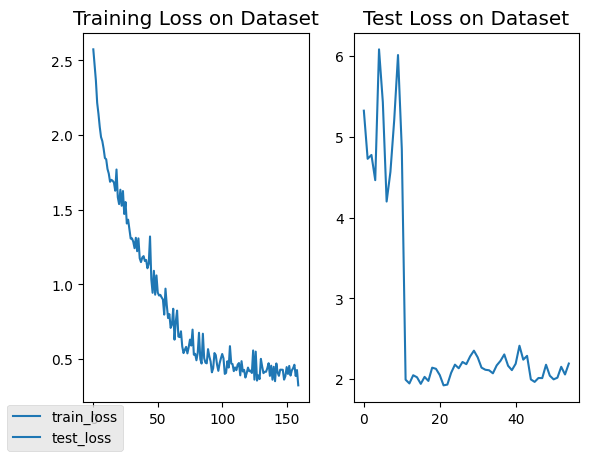

In [6]:
# plot the training loss
fig, axes = plt.subplots(1, 2)
plt.style.use("ggplot")
axes[0].plot(train_step_loss, label="train_loss")
axes[1].plot(test_step_loss, label="test_loss")
axes[0].set_title("Training Loss on Dataset")
axes[1].set_title("Test Loss on Dataset")
fig.legend(loc="lower left")

torch.Size([16, 10, 256, 256])
torch.Size([16, 256, 256])


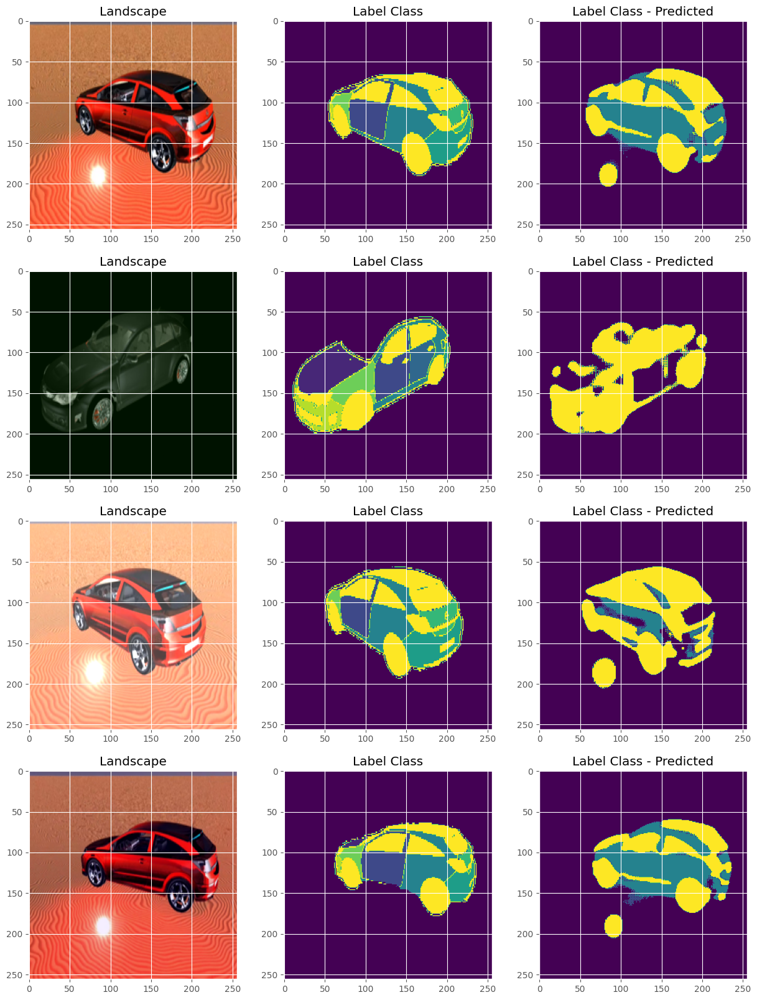

In [7]:
##Aftermath
X, Y = next(iter(trainLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([16, 10, 256, 256])
torch.Size([16, 256, 256])


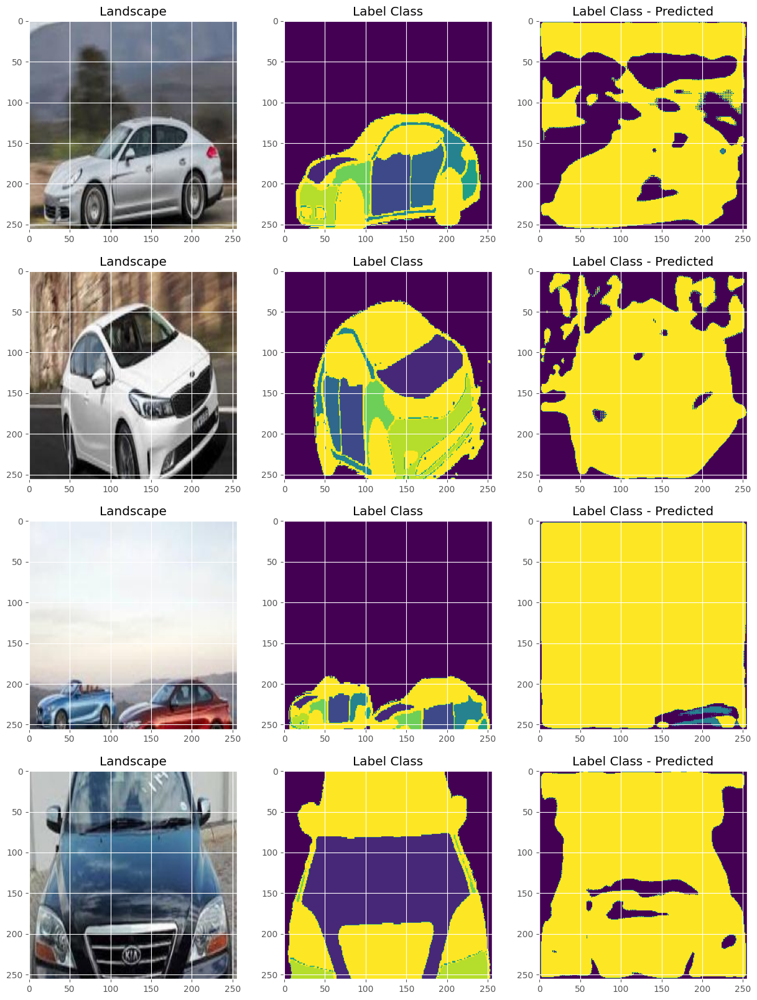

In [8]:
##Aftermath
X, Y = next(iter(testLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

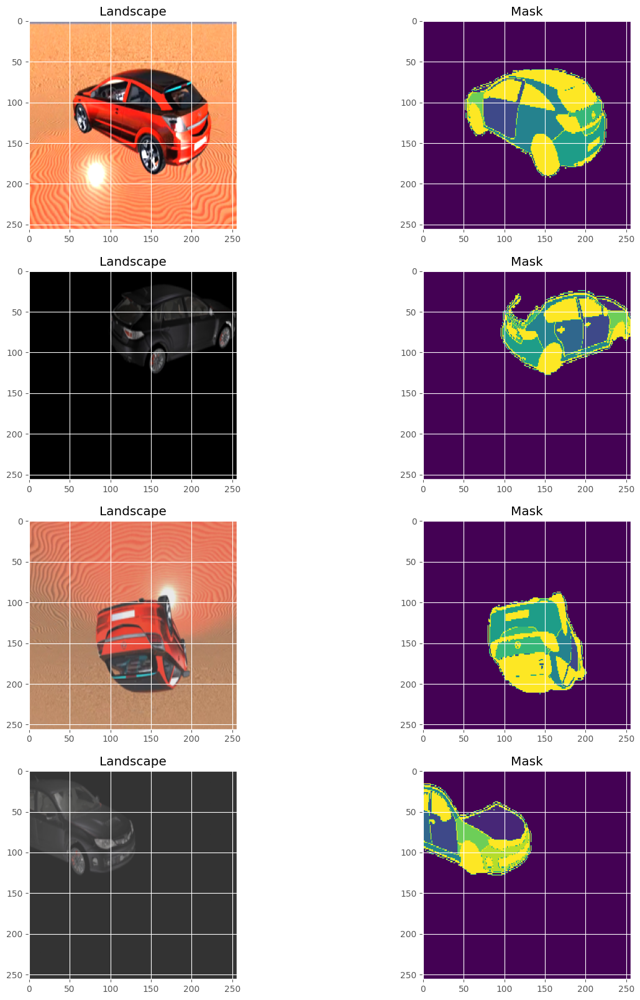

In [9]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms,test=False):
    self.arrayPaths = arrayPaths
    self.test = test
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    if (self.test):
        image = arrayz[:,:,:3]
        mask = arrayz[:,:,3]
    else:
        image = arrayz[:185,:,:3]
        mask = arrayz[:185,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)
  


# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform,test=True)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")

torch.Size([16, 10, 256, 256])
torch.Size([16, 256, 256])


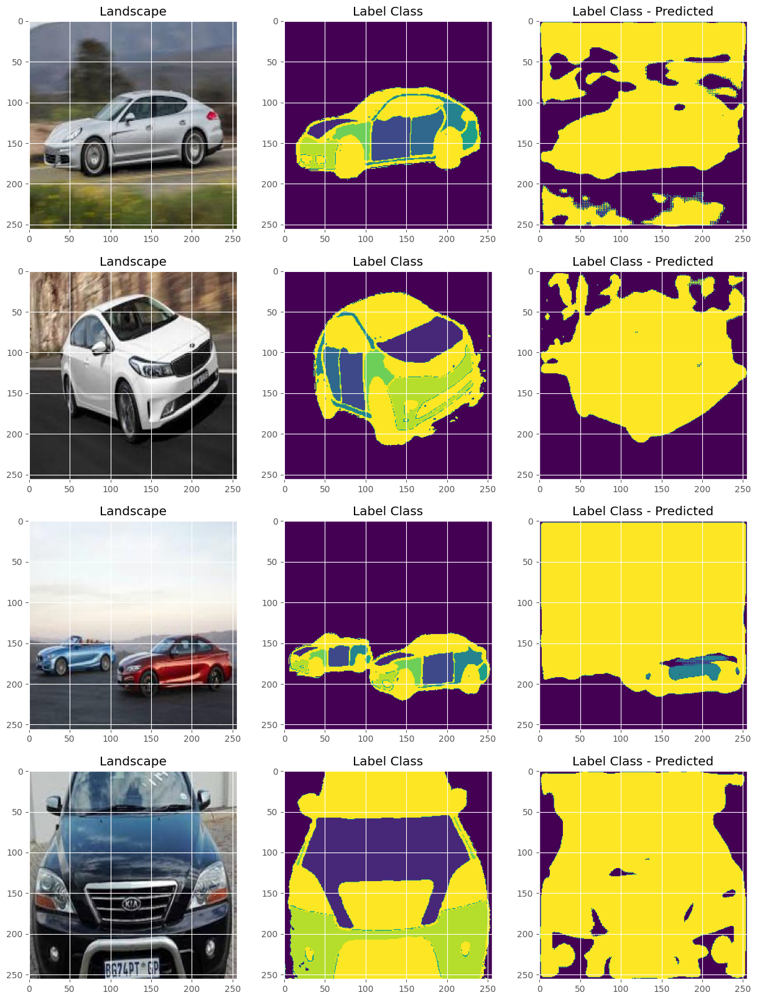

In [10]:
##Aftermath
X, Y = next(iter(testLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([16, 10, 256, 256])
torch.Size([16, 256, 256])


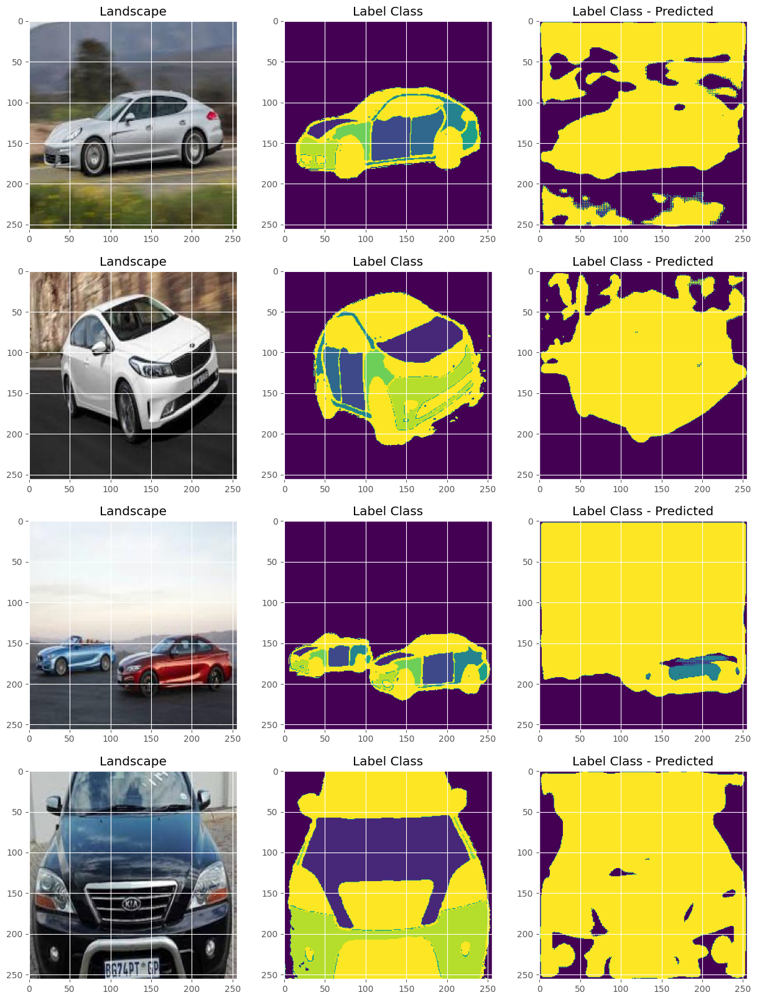

In [11]:
##Aftermath
X, Y = next(iter(testLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

torch.Size([16, 10, 256, 256])
torch.Size([16, 256, 256])


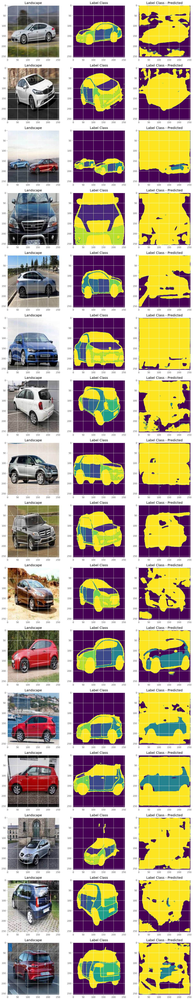

In [12]:
##Aftermath
X, Y = next(iter(testLoader))
X, Y = X.to(DEVICE), Y.to(DEVICE)
Y_pred = unet(X)
print(Y_pred.shape)
Y_pred = torch.argmax(Y_pred, dim=1)
print(Y_pred.shape)

test_batch_size=16
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = X[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = Y[i].cpu().detach().numpy()
    label_class_predicted = Y_pred[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted)
    axes[i, 2].set_title("Label Class - Predicted")

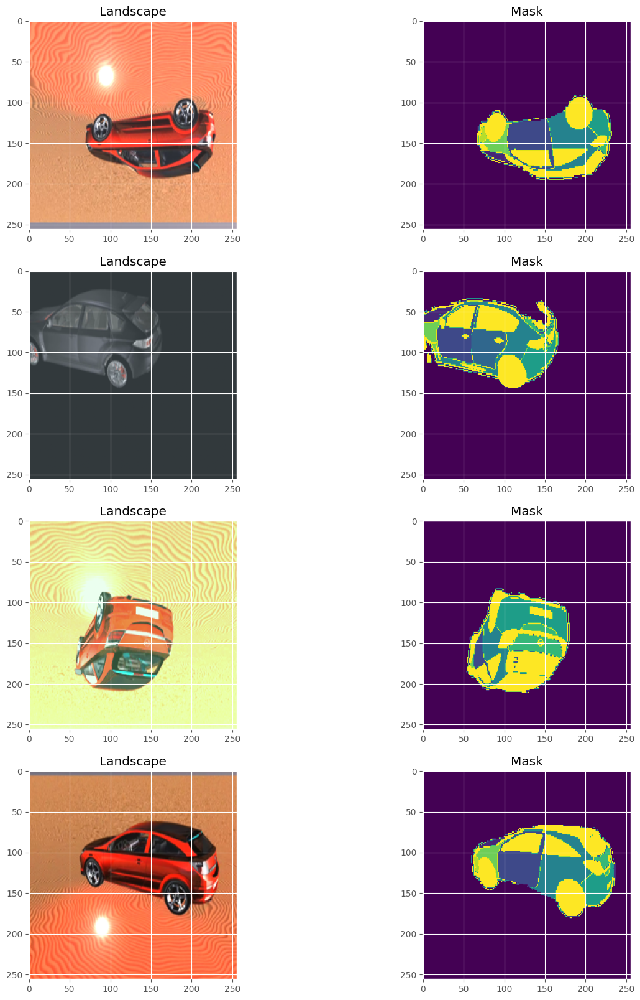

In [13]:
## Setup dataset
class imageArrayDataset(Dataset):
  def __init__(self, arrayPaths, transforms,test=False):
    self.arrayPaths = arrayPaths
    self.test = test
    self.transforms = transforms

  def __len__(self):
    return len(self.arrayPaths)

  def __getitem__(self, idx):
    #Grab image from index
    arrayPath = self.arrayPaths[idx]
    arrayz = np.load(arrayPath)

    #Preprocessing, reshape image data and mask:
    if (self.test):
        image = arrayz[:,:,:3]
        mask = arrayz[:,:,3]
    else:
        image = arrayz[:185,:,:3]
        mask = arrayz[:185,:,3]

    # check to see if we are applying any transformations
    if self.transforms is not None:
      # apply the transformations to both image and its mask
      transformed = self.transforms(image=image, mask=mask)
      image = transformed["image"]
      mask = transformed["mask"]
      # mask = torch.argmax(mask, dim=0) #VIGTIG
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()
    else:
      image = torch.from_numpy(image)
      mask = torch.from_numpy(mask)/10
      image = image.permute(2, 0, 1)
      image = image.float()/255
      mask = mask.long()

    return (image,mask)
  


# partition the data into training and testing splits using 85% of
# the data for training and the remaining 15% for testing
trainImages = train_black_5_doors_images + train_orange_3_doors_images

# define transformations
testTransform = A.Compose(
    [A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)]
)

trainTransform = A.Compose(
    [
        A.Resize(INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH),
        A.RandomBrightnessContrast(brightness_limit=(0,0.3), contrast_limit=0.5, p=0.5),
        A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, p=0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
    ]
)

# create the train and test datasets
trainDS = imageArrayDataset(arrayPaths=trainImages, transforms=trainTransform)
testDS = imageArrayDataset(arrayPaths=test_images, transforms=testTransform,test=True)

for i in range(len(testDS)):
            data, label = trainDS[i]

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY,
	num_workers=0)


imageLoad, maskLoad = next(iter(trainLoader))
imageLoad, maskLoad = imageLoad.to(DEVICE), maskLoad.to(DEVICE)

test_batch_size=4
fig, axes = plt.subplots(test_batch_size, 2, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):

    landscape = imageLoad[i].permute(1, 2, 0).cpu().detach().numpy()
    label_class = maskLoad[i].cpu().detach().numpy()

    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class)
    axes[i, 1].set_title("Mask")